In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
## Cavets
## data quality from yahoo finance, bigger problems for stoxx than sp500
## survivorship bias because we only have a current list of SP500 from wiki,
## we need the lists of delisted tickers and later added on tickers



/Users/kingf.wong/Development/alphaNovaProject/short_down_trend_follow.py:13: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/bt_tools.py:164: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()


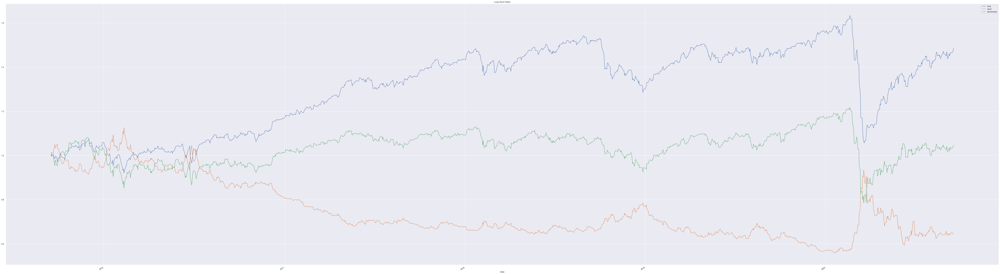

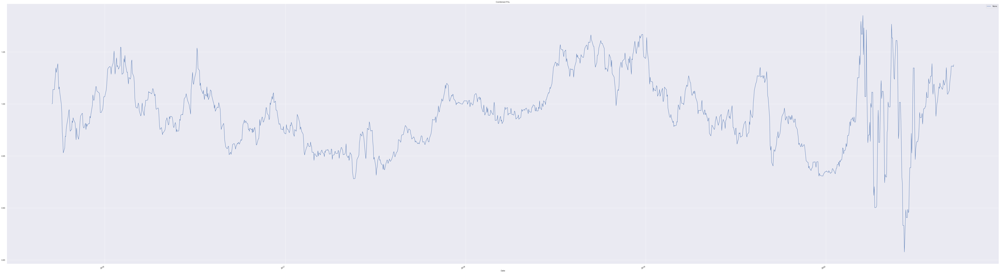

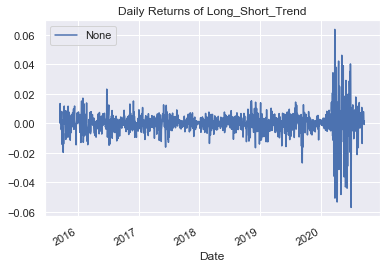

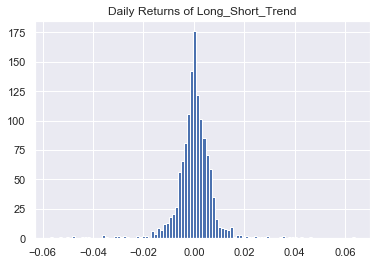

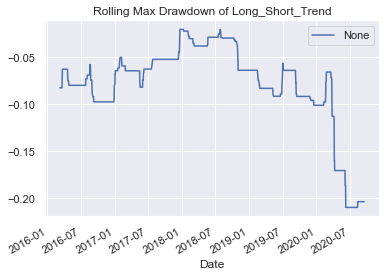

max dd: -0.20971578915503353


Profit       1.037722
Alpha        0.000090
Beta        -0.322972
Daily Vol    0.008383
MaxDD       -0.209716
IR           0.107191
dtype: float64

In [4]:
## Task 1a, go short the elements of the stoxx600 that are the mirror of your long signal (if MA20<MA50<MA150). Compare that to your last benchmark.

## Overall, not profitable, doesn't have a significant alpha and have a non-zero beta

from short_down_trend_follow import long_short_trend

long_short_trend()


/Users/kingf.wong/Development/alphaNovaProject/bt_tools.py:164: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/stress_long_trend_follow.py:90: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ncol=len(deviations)//3)


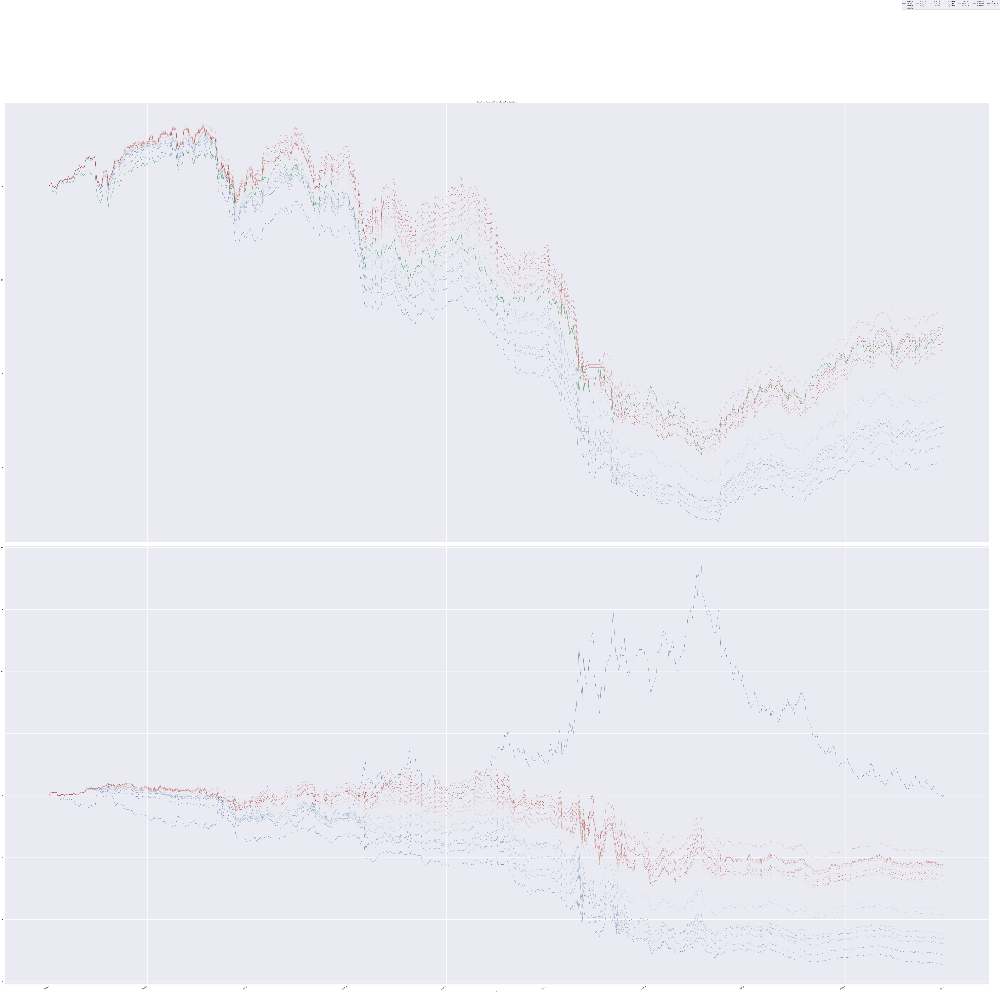

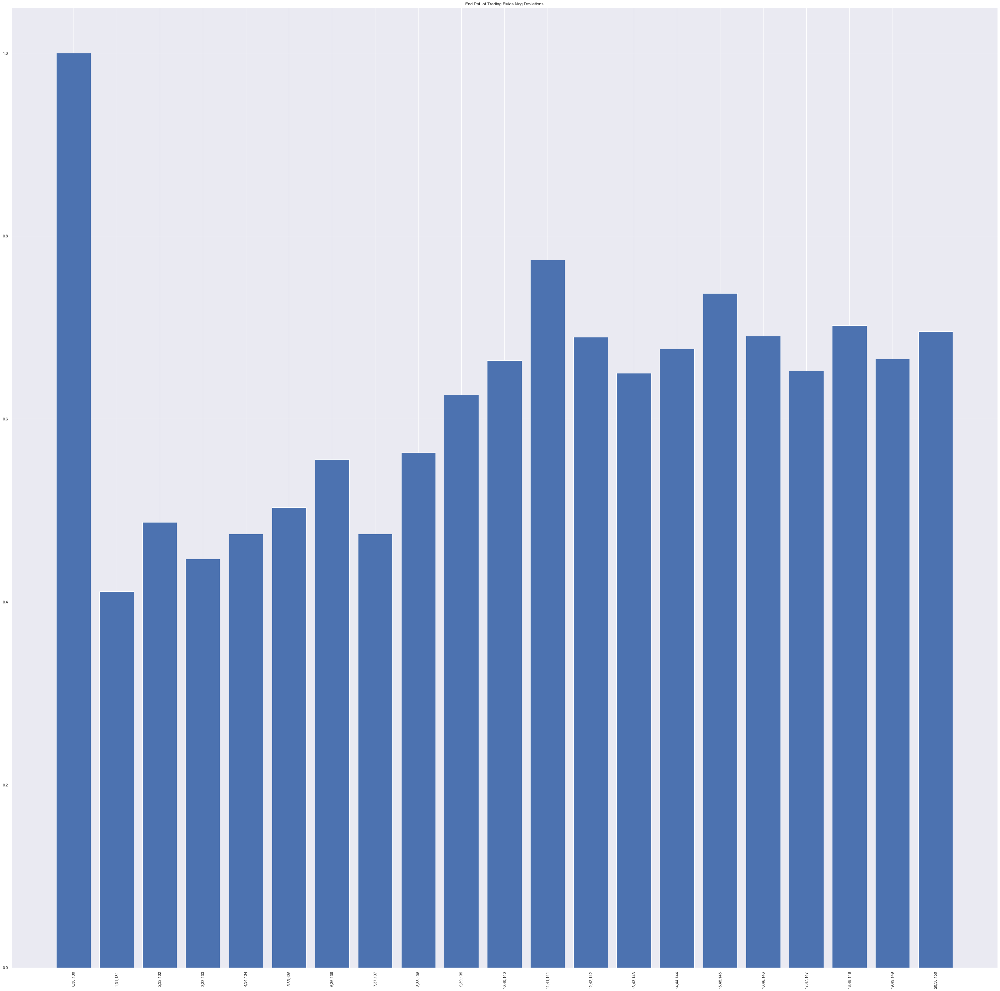

In [5]:
## Task 1b, stress testing with pos/ neg deviations of the trading rule

## For see the graphs better, I have saved them in the folder "stress_trend_follow"

## for descending freq (Minus freq), we see no trading rules variations outperform original (20,50, 150) in terms of end PnL besides (0,30,130).
## but (0,30,130) does not trade at all besides shorting the index during the stress preiod

## for ascending freq (Plus freq), we see improvement in end PnL in general until reaching the peak at (30, 60, 160), then it starts to tank


### Next step I would suggest is to test the trading rules deviation in other periods to avoid overfitting. Possibly randomise the 5 yr periods where the backtest takes place



from stress_long_trend_follow import stress_trend_follow


start_bt_date= '2007-01-01'
end_bt_date= '2010-01-01'


## Minus Trading Rules
stress_trend_follow(direction='Neg Deviations')




/Users/kingf.wong/Development/alphaNovaProject/bt_tools.py:164: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/stress_long_trend_follow.py:90: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ncol=len(deviations)//3)


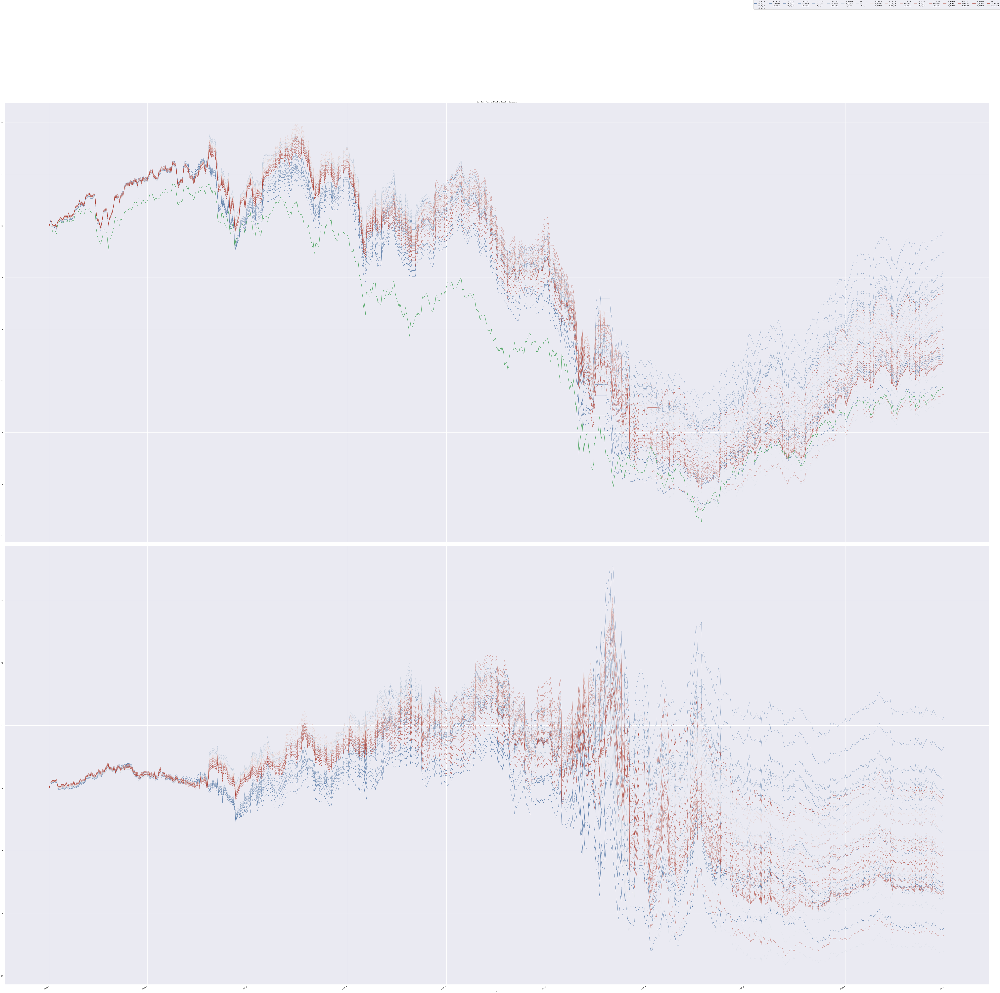

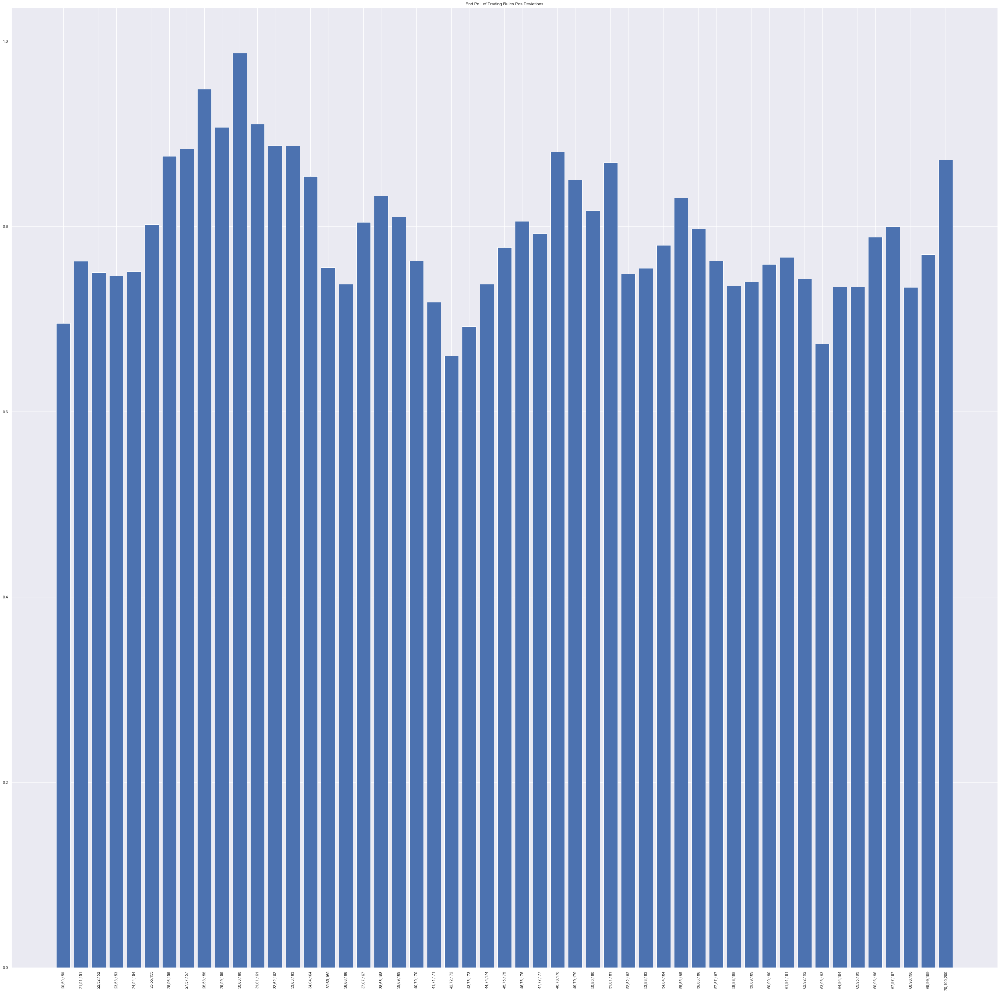

In [6]:
## Plus Trading Rules
stress_trend_follow(direction='Pos Deviations')

/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:153: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/bt_tools.py:164: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


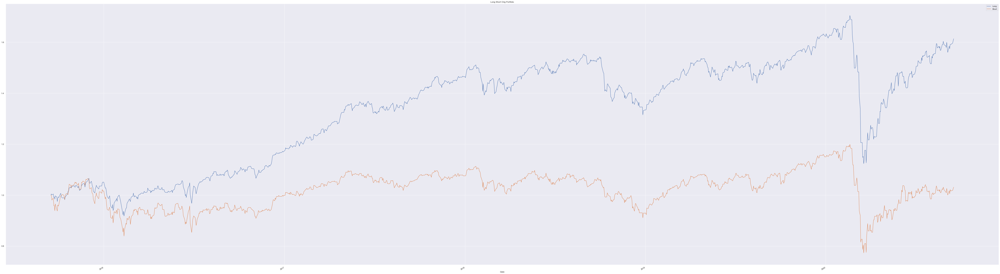

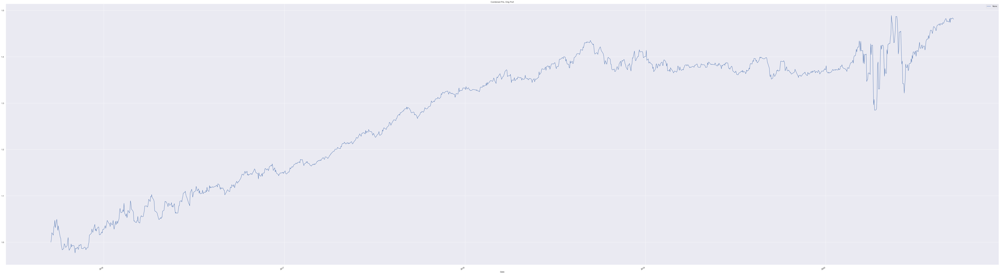

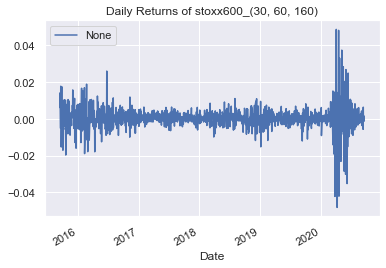

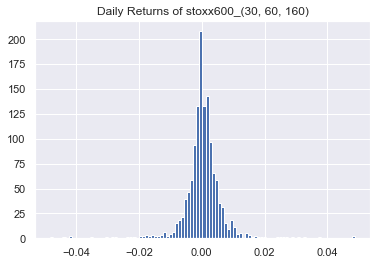

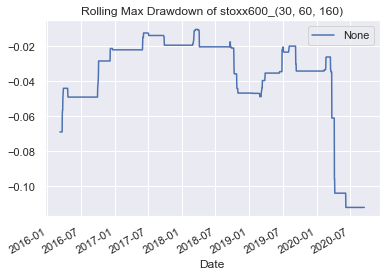

max dd: -0.112435612512498
Profit       1.481026
Alpha        0.000339
Beta        -0.348847
Daily Vol    0.006244
MaxDD       -0.112436
IR           1.699506
dtype: float64


/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


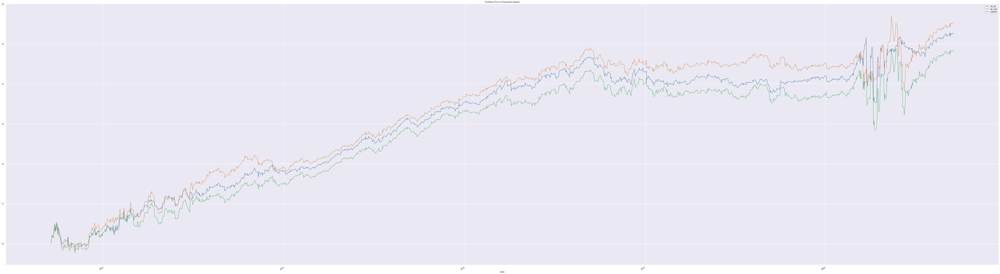

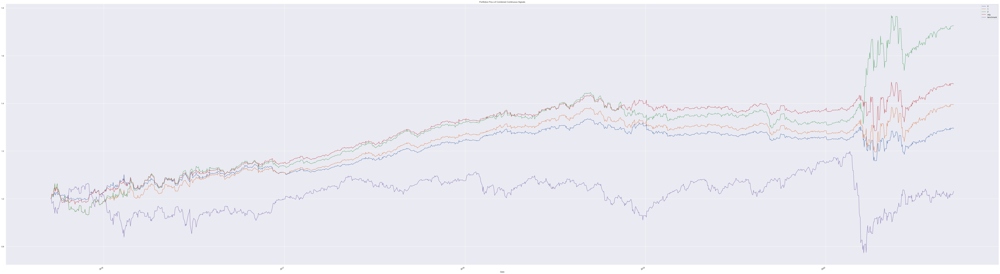

In [7]:
## Since (30, 60, 160) has the best cumulative return from 2007-2010, 
## let's backtest this for the last 5 years


from trend_following_other_indices import trend_follow

trend_follow('stoxx600', sigs=(30,60,160), transaction_cost=0)


/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:153: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/bt_tools.py:164: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


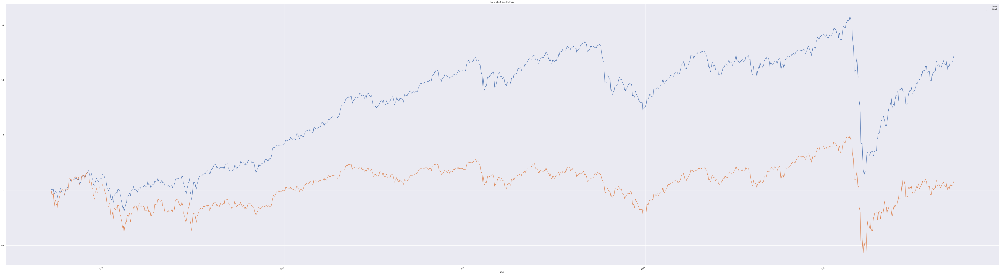

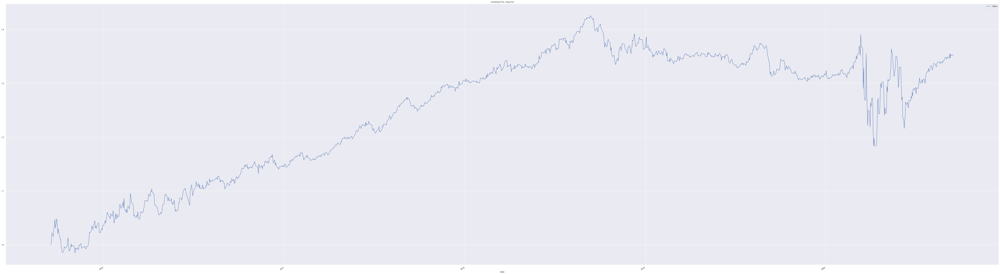

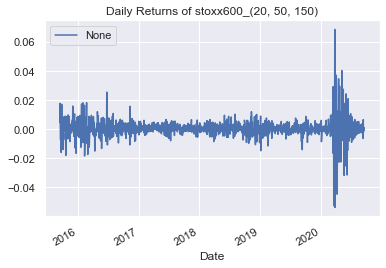

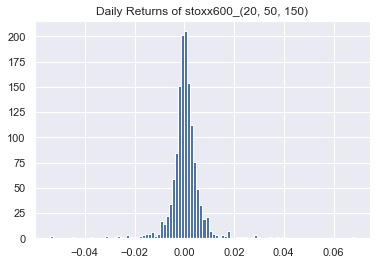

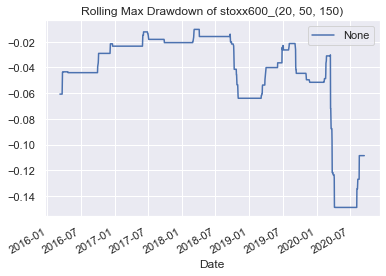

max dd: -0.14879576471102185
Profit       1.351717
Alpha        0.000274
Beta        -0.400236
Daily Vol    0.006573
MaxDD       -0.148796
IR           1.858352
dtype: float64


/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


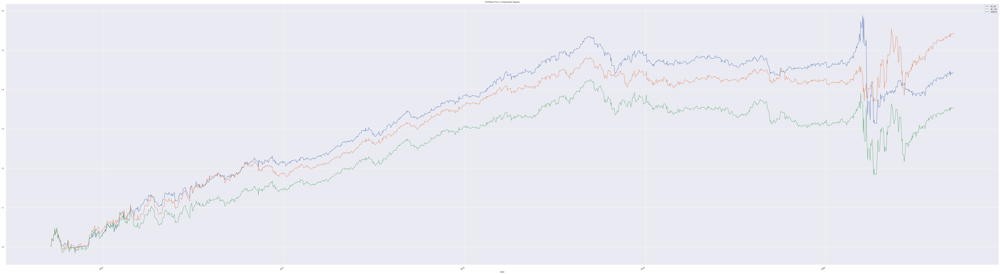

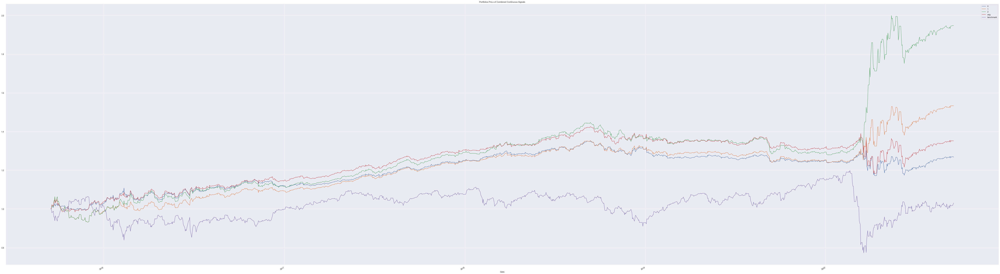

In [8]:
## Comparing to (20,50,150), 
## (30,60,160) had a higher cumulative return, highr alpha, a closer to zero beta, a lower drawdown but a slightly lower IR, 

## (30,60,160) seems to be a better trading rule than (20,50,150) for last 5 year and stress period of 2007 to 2010

trend_follow('stoxx600', sigs=(20,50,150), transaction_cost=0)

In [9]:
## Task 1c, same strat with other indices

## Cavets
## data quality from yahoo finance, bigger problems for stoxx than sp500
## survivorship bias because we only have a current list of SP500 from wiki,
## we need the list of delisted and later added on
transaction_cost=0.000

/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:153: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/bt_tools.py:441: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


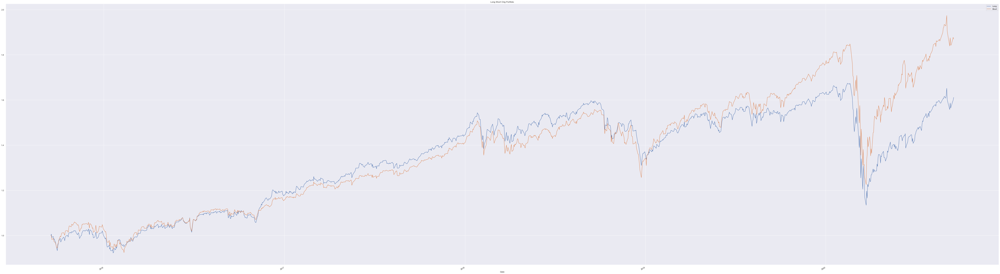

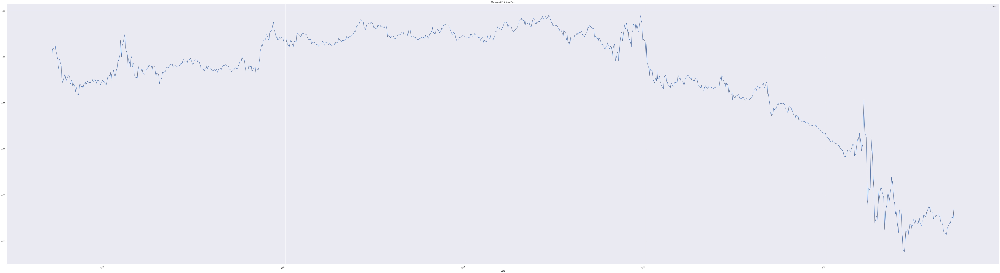

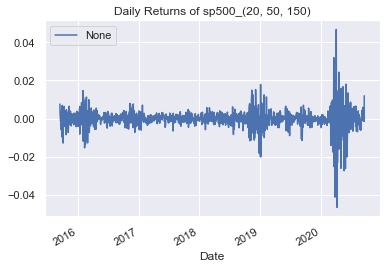

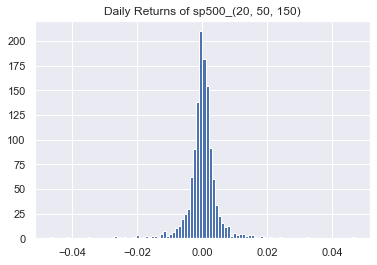

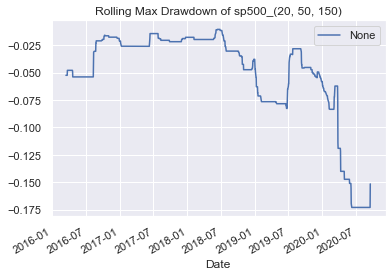

max dd: -0.17309433195297796
Profit       0.834353
Alpha       -0.000027
Beta        -0.182789
Daily Vol    0.005174
MaxDD       -0.173094
IR          -8.487815
dtype: float64


/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


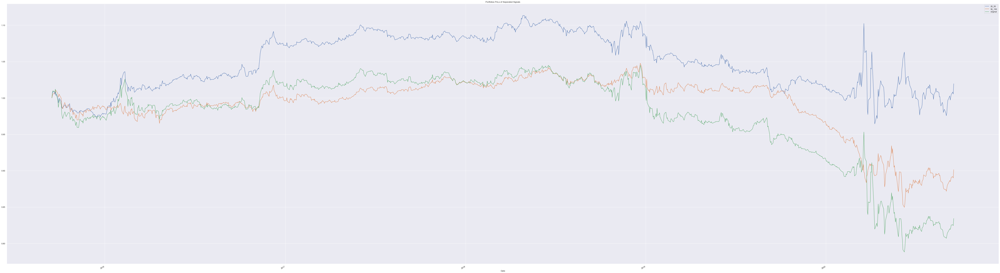

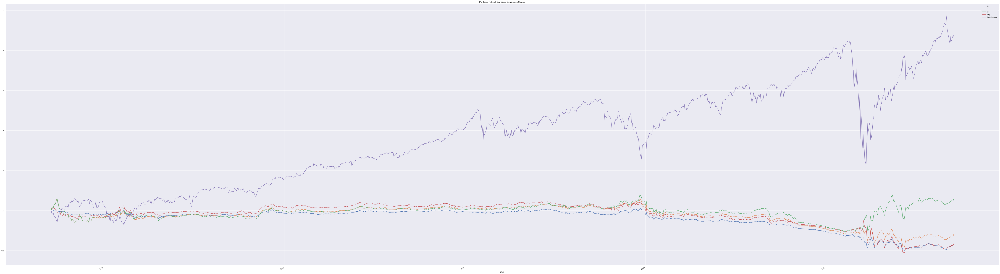

In [10]:
## SP500

trend_follow('sp500', transaction_cost=transaction_cost)

/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:153: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/bt_tools.py:441: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


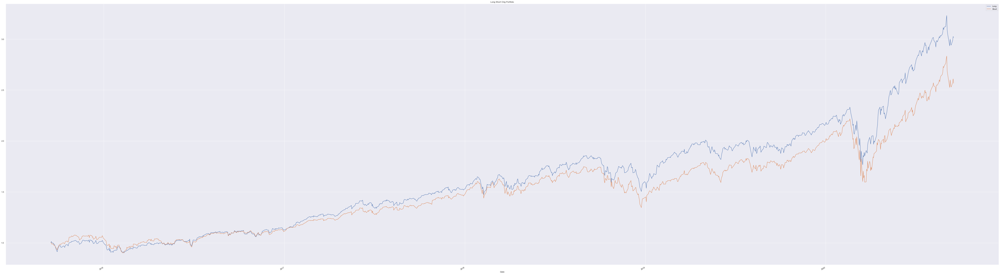

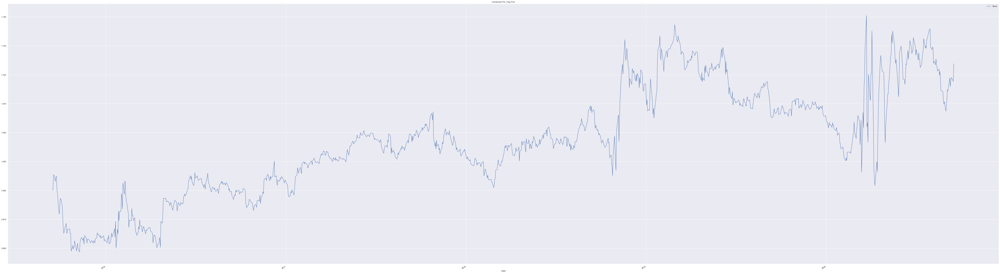

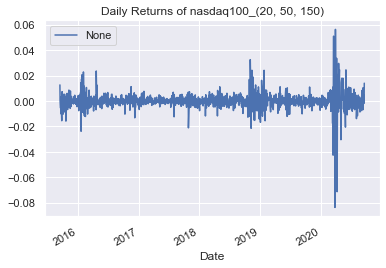

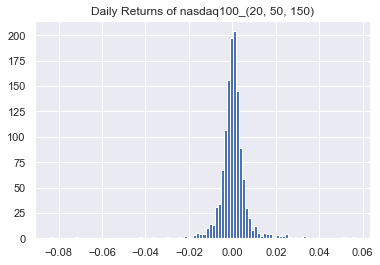

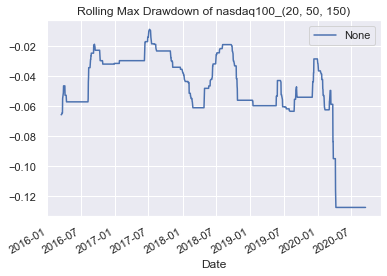

max dd: -0.12771872940294604


/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


Profit       1.109575
Alpha        0.000310
Beta        -0.239691
Daily Vol    0.006980
MaxDD       -0.127719
IR          -6.416888
dtype: float64


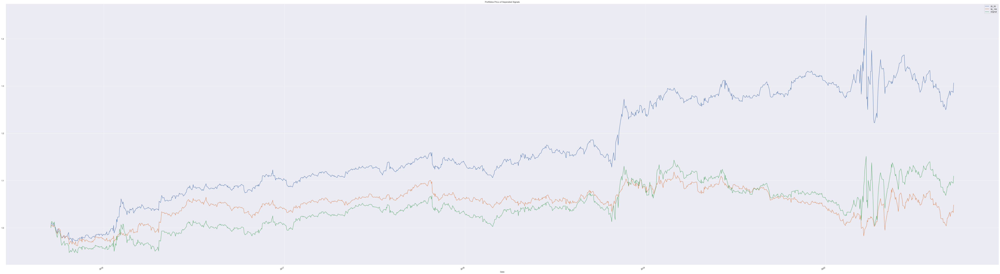

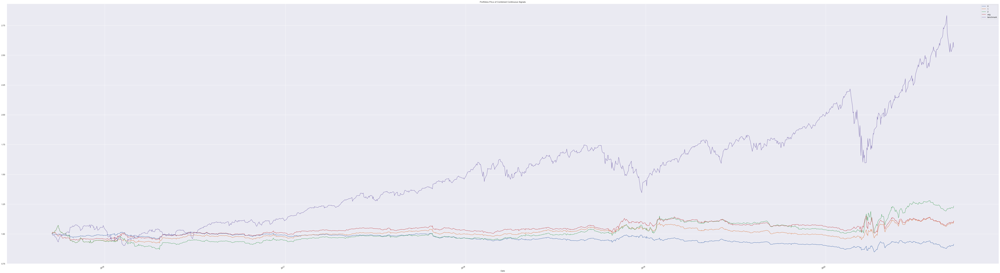

In [11]:
## Nasdaq 100

trend_follow('nasdaq100', transaction_cost=transaction_cost)

/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:153: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/bt_tools.py:441: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  today = pd.datetime.today().date()
/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


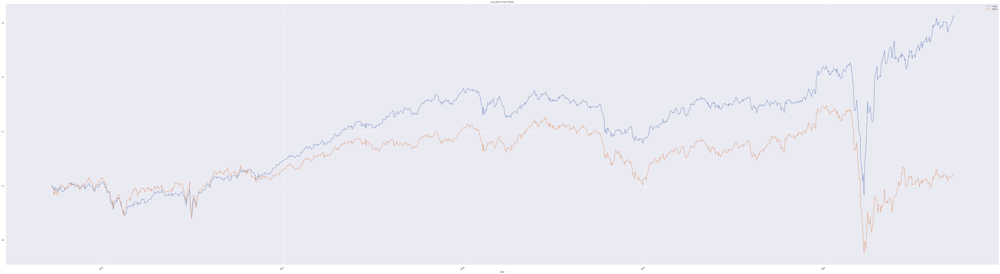

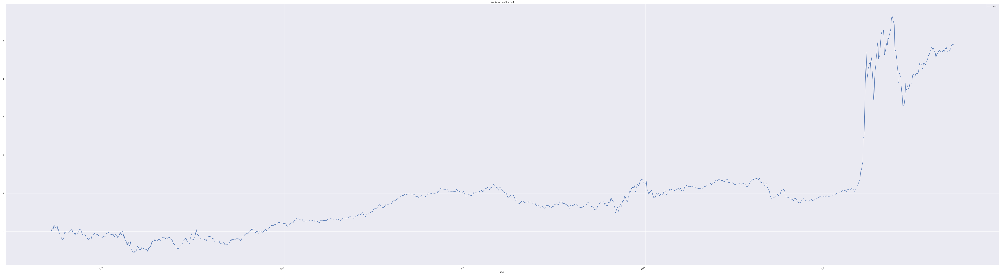

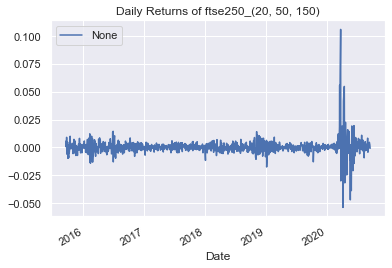

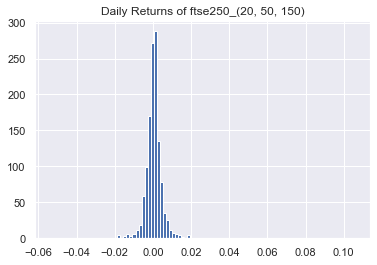

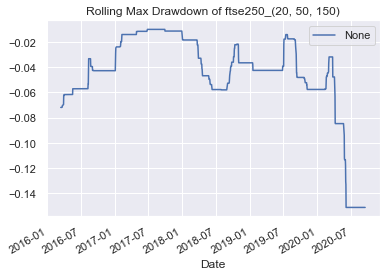

max dd: -0.15105859469126504


/Users/kingf.wong/Development/alphaNovaProject/trend_following_other_indices.py:14: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  return pd.datetime.today().date(), "-".join([str(pd.datetime.today().date().year - 5), str(pd.datetime.today().date().month), str(pd.datetime.today().date().day)])


Profit       1.490596
Alpha        0.000364
Beta        -0.282395
Daily Vol    0.006548
MaxDD       -0.151059
IR          -0.679895
dtype: float64


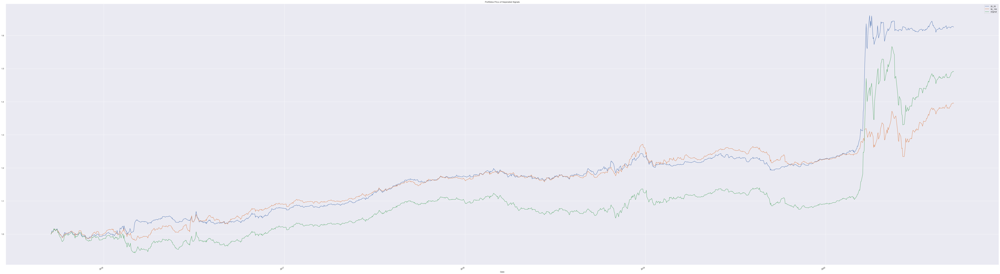

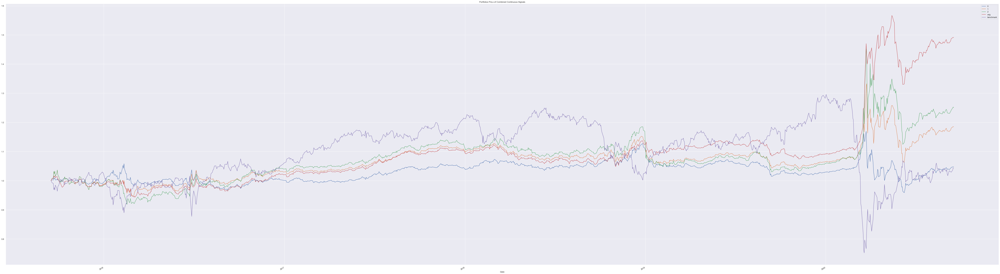

In [12]:
## FTSE 250

## Data quality is questionable, better source of data need to verify this
trend_follow('ftse250', transaction_cost=transaction_cost)